In [1]:
# libraries for querying astro images and processing them
from astroquery.alma import Alma
from astroquery.skyview import SkyView
from astropy.io import fits
from astropy.visualization import astropy_mpl_style
from astropy.modeling import models, fitting
from astropy.convolution import convolve, interpolate_replace_nans
from astropy.convolution import Gaussian2DKernel 
import os
import skimage
from skimage.filters import *
import numpy as np
from skimage import io, exposure, morphology, filters, feature
from skimage.feature import blob_dog, blob_log, blob_doh
import cv2
from math import sqrt
import scipy.optimize as opt


# plotting libraries
import pylab as py
import aplpy
import matplotlib.pyplot as plt
from matplotlib import colors

# libraries for machine learning
from sklearn import decomposition

# random libraries
import time
import math
import warnings

plt.style.use(astropy_mpl_style)

In [2]:
# FAMOUS_GALAXIES_RA_DEC = {}
# for galaxy in FAMOUS_GALAXIES_LIST:
#     galaxy_query = Alma.query_object(galaxy) 
#     FAMOUS_GALAXIES_RA_DEC[galaxy] = [galaxy_query[-1]['s_ra'], galaxy_query[-1]['s_dec']]
#     print(FAMOUS_GALAXIES_RA_DEC[galaxy])
    

In [3]:
from astroquery.skyview import SkyView


# FAMOUS_GALAXIES_LIST = ['NGC 450', 'NGC 5792', 'NGC 4437', 
#                         'NGC 1032', 'NGC 4753',
#                         'NGC 60', 'NGC 5496', 'NGC 936',
# #                         ]

# FAMOUS_GALAXIES_LIST = ['SDSS J011530.44-005139.5', 'SDSS J145822.55-010526.7', 'SDSS J123245.66+000650.3',
#                        'SDSS J023923.65+010536.8', 'SDSS J125222.06-011158.4', 'SDSS J001558.24-001812.6',
#                        'SDSS J141137.41-010927.2', 'SDSS J022737.46-010921.6']
galaxy_images = {}

def find_galaxy_r50(galaxy):
    ra_dec = FAMOUS_GALAXIES_RA_DEC[galaxy]
    ra = ra_dec[0]
    dec = ra_dec[1]
    # query for r50 using IAU name/radec
    # return galaxy r50
    

for galaxy in FAMOUS_GALAXIES_LIST:
    img = SkyView.get_images(galaxy,survey=['SDSSi'], pixels=150,)
    original_img_data = img[0][0].data.copy()
    galaxy_images[galaxy] = original_img_data
    result = cv2.imwrite('original_images/{}.jpg'.format(galaxy), original_img_data)
    if result == True:
        print('Image saved successfully')
    else:
        print('Failed to save image')


fig, axes = plt.subplots(2, 4, figsize=(15, 5), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

for galaxy, original_img_data in galaxy_images.items():
    ax[i].set_title(galaxy)
    ax[i].imshow(original_img_data)
    i += 1
    

plt.tight_layout()
plt.show()

NameError: name 'FAMOUS_GALAXIES_LIST' is not defined

In [15]:
drpall = fits.open('drpall-v2_1_2.fits')
drpall_data = drpall[1].data

nsa = fits.open('nsa_v1_0_1.fits')
nsa_data = nsa[1].data

NO_GALAXY = 40

nsa_names = nsa_data['IAUNAME'][0:NO_GALAXY]
nsa_ra = nsa_data['RA'][0:NO_GALAXY]
nsa_dec = nsa_data['DEC'][0:NO_GALAXY]
nsa_petroth50 = nsa_data['PETRO_TH50'][0:NO_GALAXY]
nsa_petroth90 = nsa_data['PETRO_TH90'][0:NO_GALAXY]
nsa_zdist = nsa_data['zdist'][0:NO_GALAXY]
nsa_ang = nsa_data['SERSIC_PHI'][0:NO_GALAXY]

# print(nsa[1].header)




In [18]:
def apparent_angle(petroth90, zdist):
    delta = 2*math.atan(petroth90/zdist)
    return delta

standard_aa = apparent_angle(nsa_petroth90[0], nsa_zdist[0])
print(standard_aa)


3.137634711702541


In [19]:
nsa_galaxy_images = {}
for name, ra, dec, petroth90, zdist in zip(nsa_names, nsa_ra, nsa_dec, nsa_petroth90, nsa_zdist):
    radec = str(ra) + ',' + str(dec)
    
    aa = apparent_angle(petroth90, zdist)
    no_pixels = aa/standard_aa * 140
    
    print(name)
    print(petroth90, zdist)
    
    
    img = SkyView.get_images(position=radec, survey=['SDSSi'], pixels=int(no_pixels),)
    original_img_data = img[0][0].data.copy()
    nsa_galaxy_images[name] = original_img_data
    result = cv2.imwrite('original_images/{}.jpg'.format(name), original_img_data)
    if result == True:
        print('Image saved successfully')
    else:
        print('Failed to save image')


J094651.40-010228.5
10.453795 0.020687785
Image saved successfully
J094630.85-004554.5
6.7219906 0.06403577
Image saved successfully
J094631.59-005917.7
5.1779103 0.052030597
Image saved successfully
J094744.18-004013.4
9.177605 0.1206503
Image saved successfully
J094751.74-003242.0
10.253274 0.05536205
Image saved successfully
J094751.24-004533.5
4.8975 0.09646486
Image saved successfully
J094726.35-004832.0
7.95873 0.125968
Image saved successfully
J094622.25-004536.9
7.6296973 0.06433888
Image saved successfully
J094654.77-003324.5
37.558548 0.088694006
Image saved successfully
J094625.73-011426.7
14.22231 0.08997462
Image saved successfully
J094844.82-002937.7
18.740425 0.08969857
Image saved successfully
J094749.45-002032.2
14.762701 0.13406454
Image saved successfully
J094842.33-002114.5
24.108818 0.0068420386
Image saved successfully
J094859.52-000208.5
6.6866083 0.08358431
Image saved successfully
J094740.82-001823.2
7.259929 0.13086501
Image saved successfully
J094919.08+00014

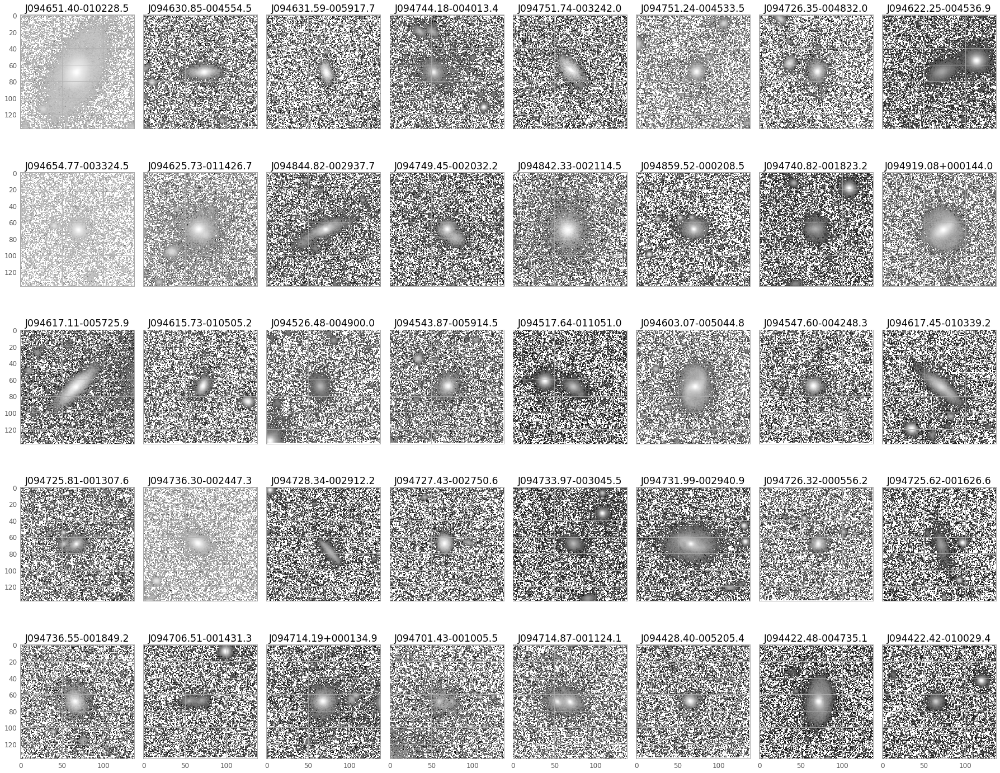

In [21]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

for galaxy, original_img_data in nsa_galaxy_images.items():
#     norm = colors.LogNorm(original_img_data.mean() + 0.5 * original_img_data.std(), original_img_data.max(), clip='True')
    norm = colors.LogNorm()
    ax[i].set_title(galaxy)
    ax[i].imshow(original_img_data, norm=norm, cmap='gray')
    i += 1
    

plt.tight_layout()
plt.show()

In [28]:
print(float(nsa_ang[0]))

15.97821044921875


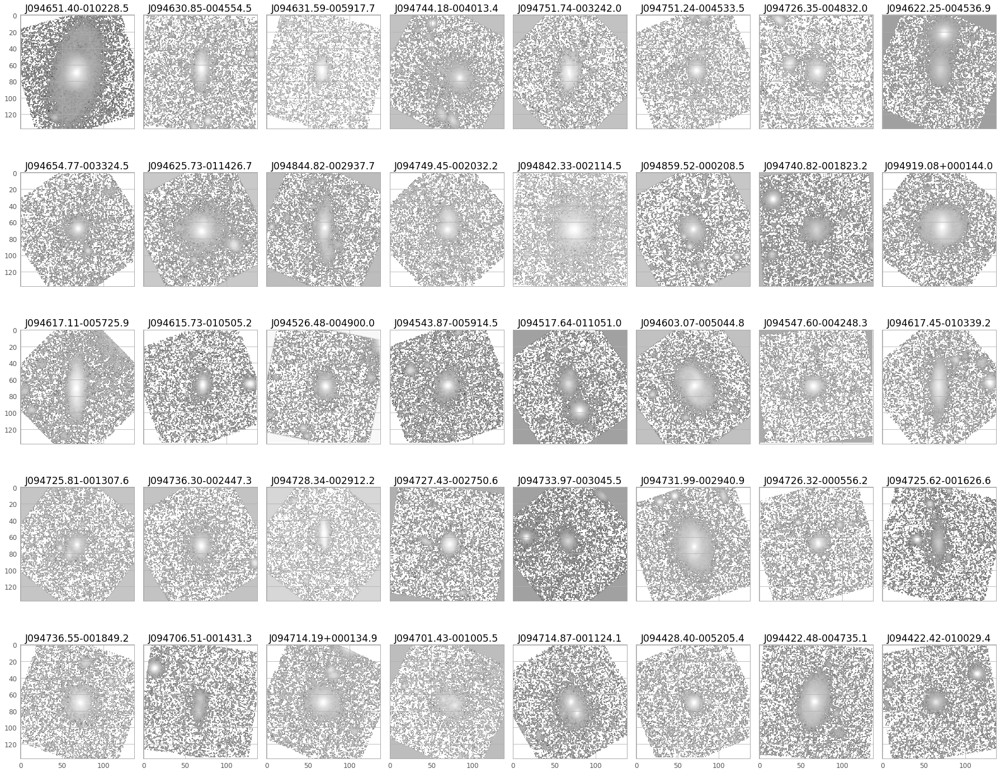

In [37]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

from skimage import transform
import skimage
import random

for galaxy, original_img_data in nsa_galaxy_images.items():
    mean = np.nanmean(original_img_data)
    std = np.nanstd(original_img_data)
    rotated_image = transform.rotate(original_img_data.byteswap().newbyteorder(), float(nsa_ang[i]),
                                    mode='constant', cval=random.gauss(mean, std))
    norm = colors.LogNorm()
    ax[i].set_title(galaxy)
    ax[i].imshow(rotated_image, norm=norm, cmap='gray')
    i += 1

plt.tight_layout()
plt.show()

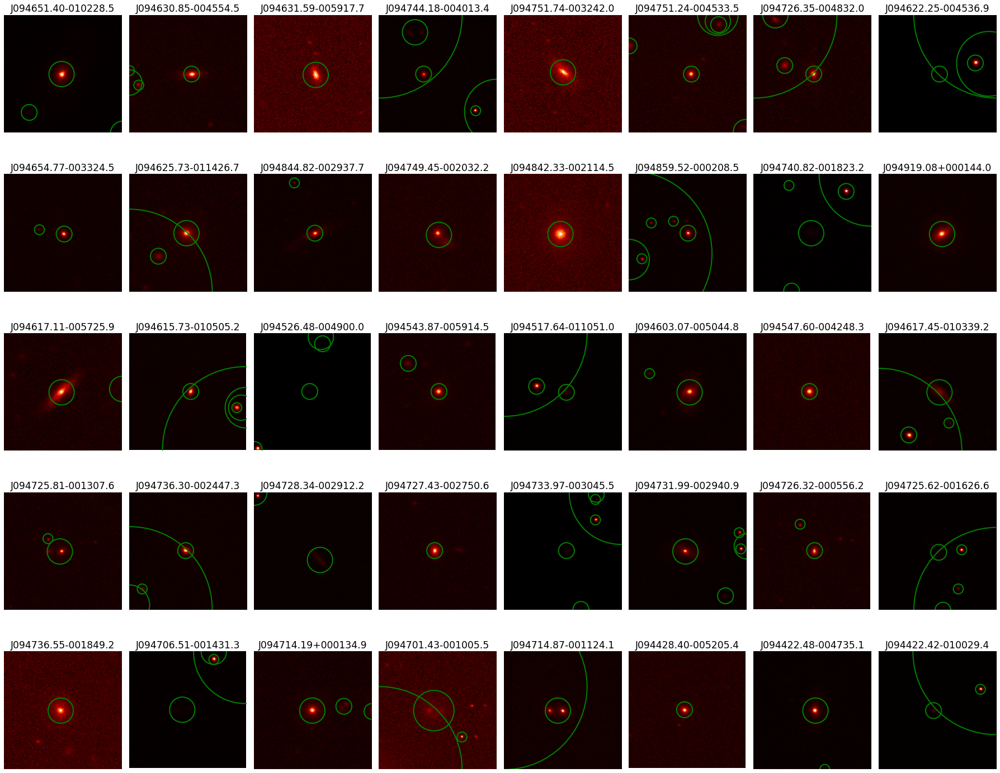

In [22]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0



for galaxy, original_img_data in nsa_galaxy_images.items():
    
    blurred_img = skimage.filters.gaussian(original_img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=100, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)


    ax[i].set_title(galaxy)
    ax[i].imshow(original_img_data)

    for blob in blobs_dog:
            
        y, x, r = blob
        c = plt.Circle((x, y), r, color='green', linewidth=2, fill=False)

        ax[i].add_patch(c)
        ax[i].set_axis_off()

    i += 1

plt.tight_layout()
plt.show()


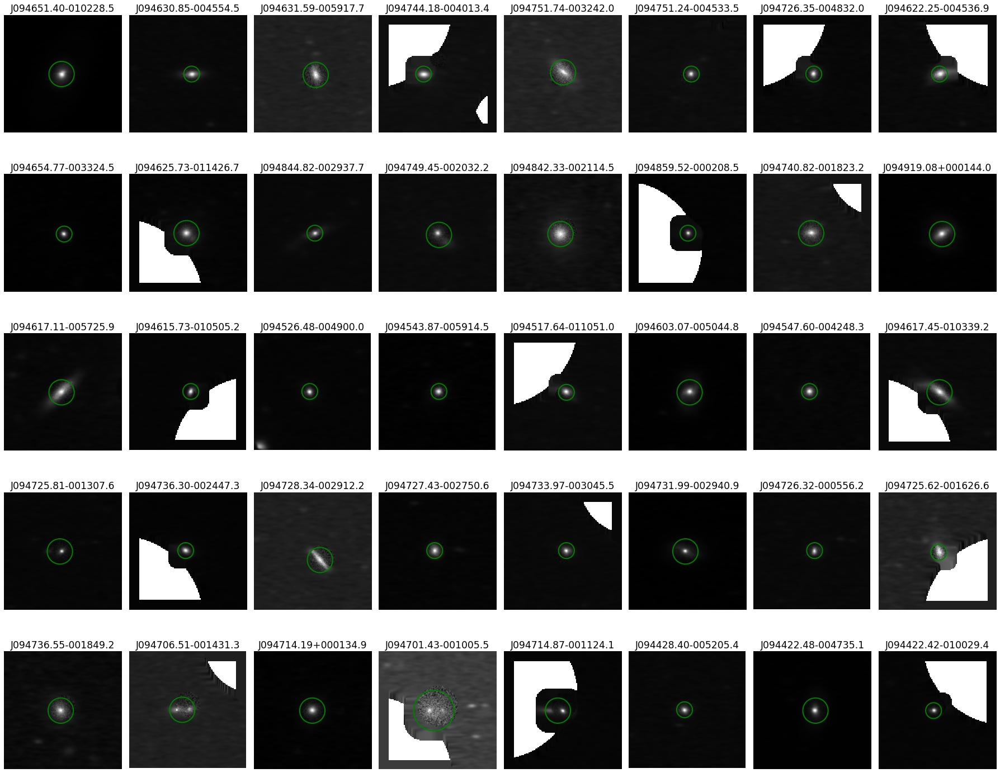

In [23]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

def find_len(point1, point2):
    """find length using pythagoras theorem"""
    return sqrt((point2[1]-point1[1])**2 + (point2[0]-point1[0])**2)


for galaxy, original_img_data in nsa_galaxy_images.items():

    blurred_img = skimage.filters.gaussian(original_img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=100, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    initialise = False
    center_point = [original_img_data.shape[0]/2, original_img_data.shape[1]/2]

    for blob in blobs_dog:
        
        y, x, r = blob
        center_of_blob = [x, y]


        if initialise == False:
            center_blob = blob
            dist_of_current_cb = find_len(center_of_blob, center_point)
            initialise = True
        
        else:
            
            check1 = find_len(center_of_blob, center_point) < dist_of_current_cb
            check2 = find_len(center_of_blob, center_point) < r
            
            if check1 == True and check2 == True:
                center_blob = blob
                dist_of_current_cb = find_len(center_of_blob, center_point)


    # mask

    outside_blobs = []

    for blob in blobs_dog:
        if np.any(blob != center_blob):
            outside_blobs.append(blob)

    def mask_outside_blobs(image, outside_blobs, center_blob):
        edited_image = image.copy()
        cb_y, cb_x, cb_r = center_blob
        for outside_blob in outside_blobs:
            
            y, x, r = outside_blob
            for i in range(image.shape[0]):
                for j in range(image.shape[1]):
                    if find_len([i, j], [x, y]) <= r and find_len([i, j], [cb_x, cb_y]) > cb_r:
                        edited_image[j][i] = np.NaN
        return edited_image

        
    cb_y, cb_x, cb_r = center_blob

    img_data = mask_outside_blobs(original_img_data, outside_blobs, center_blob) 

    # interpolation

    def interpolate(original_img_data, image, center_blob):
        cb_y, cb_x, cb_r = center_blob
        kernel = Gaussian2DKernel(x_stddev=3, y_stddev=1)
        new_image = convolve(image, kernel)
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if find_len([i, j], [cb_x, cb_y]) < cb_r:
                    new_image[i, j] = original_img_data[i, j]
        return new_image
    
    img_data = interpolate(original_img_data, img_data, center_blob)

    c = plt.Circle((cb_x, cb_y), cb_r, color='green', linewidth=2, fill=False)

    ax[i].set_title(galaxy)
    ax[i].imshow(img_data, cmap='gray')
    ax[i].add_patch(c)
    ax[i].set_axis_off()

    i += 1

plt.tight_layout()
plt.show()


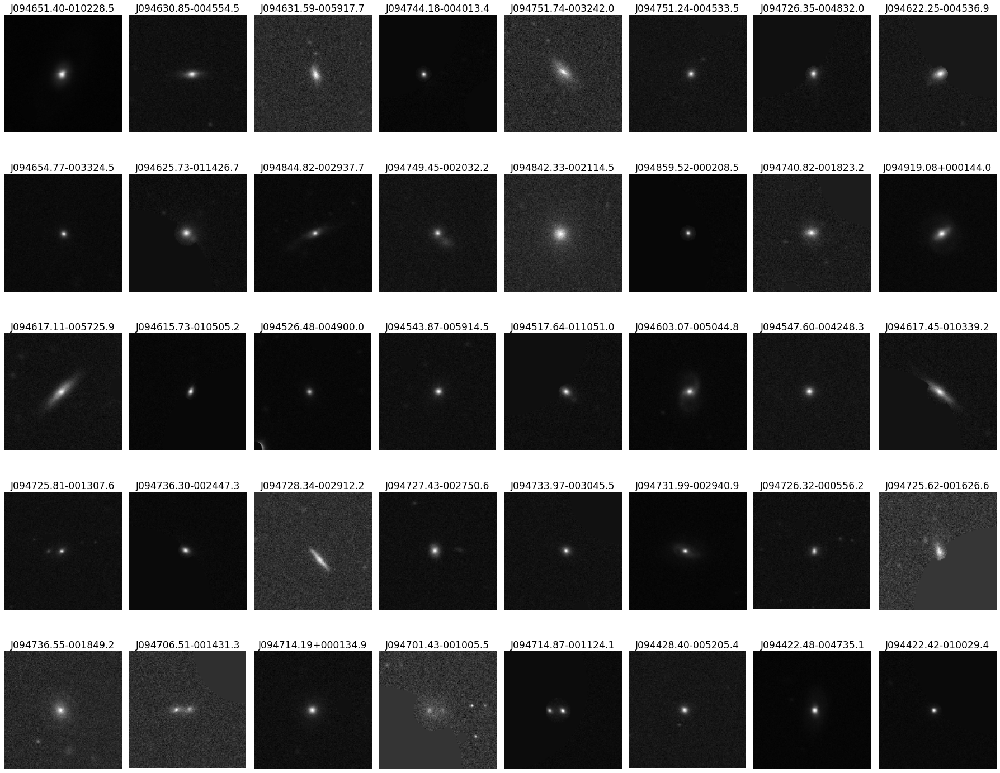

In [24]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

def find_len(point1, point2):
    """find length using pythagoras theorem"""
    return sqrt((point2[1]-point1[1])**2 + (point2[0]-point1[0])**2)

edited_galaxy_images = {}

for galaxy, original_img_data in nsa_galaxy_images.items():

    blurred_img = skimage.filters.gaussian(original_img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=100, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    initialise = False
    center_point = [original_img_data.shape[0]/2, original_img_data.shape[1]/2]

    for blob in blobs_dog:
        
        y, x, r = blob
        center_of_blob = [x, y]


        if initialise == False:
            center_blob = blob
            dist_of_current_cb = find_len(center_of_blob, center_point)
            initialise = True
        
        else:
            
            check1 = find_len(center_of_blob, center_point) < dist_of_current_cb
            check2 = find_len(center_of_blob, center_point) < r
            
            if check1 == True and check2 == True:
                center_blob = blob
                dist_of_current_cb = find_len(center_of_blob, center_point)


    # mask

    outside_blobs = []

    for blob in blobs_dog:
        if np.any(blob != center_blob):
            outside_blobs.append(blob)

    def mask_outside_blobs(image, outside_blobs, center_blob):
        edited_image = image.copy()
        cb_y, cb_x, cb_r = center_blob
        for outside_blob in outside_blobs:
            
            y, x, r = outside_blob
            for i in range(image.shape[0]):
                for j in range(image.shape[1]):
                    if find_len([i, j], [x, y]) <= r and find_len([i, j], [cb_x, cb_y]) > cb_r:
                        edited_image[j][i] = np.NaN
        return edited_image

    def interpolate(image, center_blob):
        cb_y, cb_x, cb_r = center_blob
        copy = image.copy()
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if find_len([i, j], [cb_x, cb_y]) < cb_r:
                    copy[i][j] = np.NaN
        mean = np.nanmean(copy)
        
        new_image = np.nan_to_num(image, nan=mean)
        
        return new_image
    
    cb_y, cb_x, cb_r = center_blob

    img_data = mask_outside_blobs(original_img_data, outside_blobs, center_blob) 
    img_data = interpolate(img_data, center_blob)
    
#     norm = colors.LogNorm()
    ax[i].set_title(galaxy)
    ax[i].imshow(img_data, cmap='gray',)
    ax[i].set_axis_off()
    
    i += 1
    
    edited_galaxy_images[galaxy] = img_data

plt.tight_layout()
plt.show()


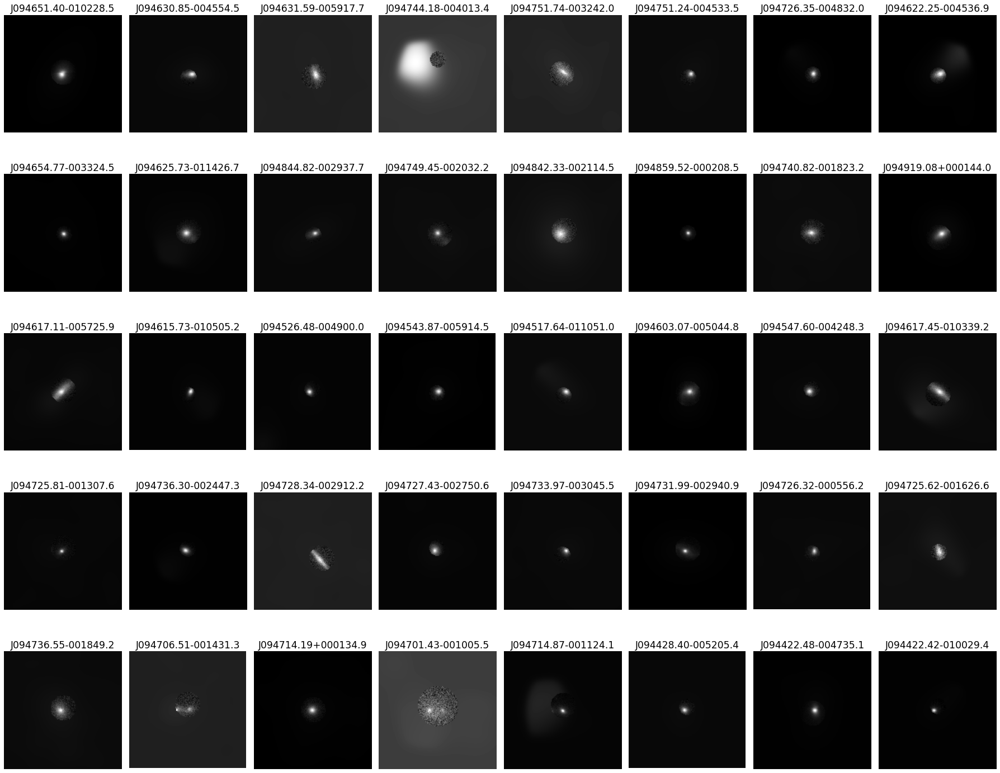

In [25]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

def find_len(point1, point2):
    """find length using pythagoras theorem"""
    return sqrt((point2[1]-point1[1])**2 + (point2[0]-point1[0])**2)

edited_galaxy_images = {}

for galaxy, original_img_data in nsa_galaxy_images.items():

    blurred_img = skimage.filters.gaussian(original_img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=100, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    initialise = False
    center_point = [original_img_data.shape[0]/2, original_img_data.shape[1]/2]

    for blob in blobs_dog:
        
        y, x, r = blob
        center_of_blob = [x, y]


        if initialise == False:
            center_blob = blob
            dist_of_current_cb = find_len(center_of_blob, center_point)
            initialise = True
        
        else:
            
            check1 = find_len(center_of_blob, center_point) < dist_of_current_cb
            check2 = find_len(center_of_blob, center_point) < r
            
            if check1 == True and check2 == True:
                center_blob = blob
                dist_of_current_cb = find_len(center_of_blob, center_point)


    # mask

    outside_blobs = []

    for blob in blobs_dog:
        if np.any(blob != center_blob):
            outside_blobs.append(blob)

    def mask_outside_blobs(image, outside_blobs, center_blob):
        edited_image = image.copy()
        cb_y, cb_x, cb_r = center_blob
        for outside_blob in outside_blobs:
            
            y, x, r = outside_blob
            for i in range(image.shape[0]):
                for j in range(image.shape[1]):
                    if find_len([i, j], [x, y]) <= r and find_len([i, j], [cb_x, cb_y]) > cb_r:
                        edited_image[j][i] = np.NaN
        return edited_image

    
    cb_y, cb_x, cb_r = center_blob
    
    from astropy.convolution import Box2DKernel
    kernel = Gaussian2DKernel(12, 12)

    img_data = mask_outside_blobs(original_img_data, outside_blobs, center_blob) 
    
    for a in range(img_data.shape[0]):
        for b in range(img_data.shape[1]):
            if find_len([a, b], [cb_x, cb_y]) <= cb_r:
                img_data[a][b] = np.NaN
            
    img_data = convolve(img_data, kernel)
    
    for a in range(img_data.shape[0]):
        for b in range(img_data.shape[1]):
            if find_len([a, b], [cb_x, cb_y]) <= cb_r:
                img_data[a][b] = original_img_data[a][b]
                

    ax[i].set_title(galaxy)
    ax[i].imshow(img_data, cmap='gray',) #norm = colors.LogNorm()
    ax[i].set_axis_off()
    
    i += 1
    
    edited_galaxy_images[galaxy] = img_data

plt.tight_layout()
plt.show()


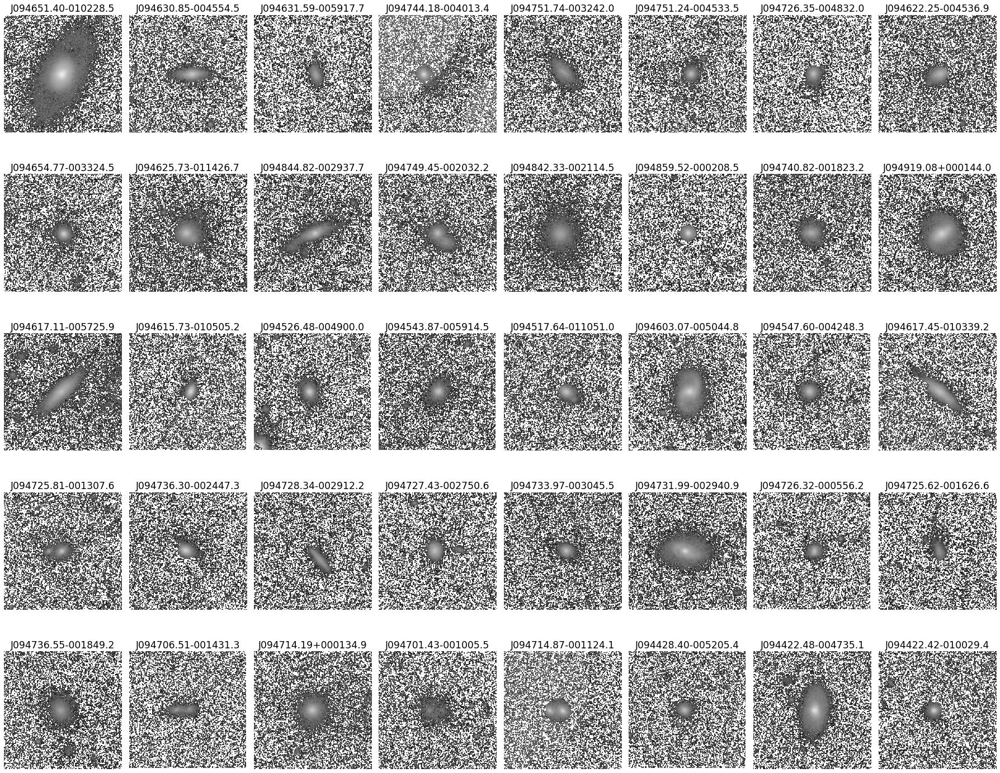

In [26]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

def find_len(point1, point2):
    """find length using pythagoras theorem"""
    return sqrt((point2[1]-point1[1])**2 + (point2[0]-point1[0])**2)

edited_galaxy_images = {}

for galaxy, original_img_data in nsa_galaxy_images.items():

    blurred_img = skimage.filters.gaussian(original_img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=150, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    initialise = False
    center_point = [original_img_data.shape[0]/2, original_img_data.shape[1]/2]

    for blob in blobs_dog:
        
        y, x, r = blob
        center_of_blob = [x, y]


        if initialise == False:
            center_blob = blob
            dist_of_current_cb = find_len(center_of_blob, center_point)
            initialise = True
        
        else:
            
            check1 = find_len(center_of_blob, center_point) < dist_of_current_cb
            check2 = find_len(center_of_blob, center_point) < r
            
            if check1 == True and check2 == True:
                center_blob = blob
                dist_of_current_cb = find_len(center_of_blob, center_point)


    # mask

    outside_blobs = []

    for blob in blobs_dog:
        if np.any(blob != center_blob):
            outside_blobs.append(blob)

    def mask_outside_blobs(image, outside_blobs, center_blob):
        edited_image = image.copy()
        cb_y, cb_x, cb_r = center_blob
        for outside_blob in outside_blobs:
            
            y, x, r = outside_blob
            for i in range(image.shape[0]):
                for j in range(image.shape[1]):
                    if find_len([i, j], [x, y]) <= r and find_len([i, j], [cb_x, cb_y]) > cb_r:
                        edited_image[j][i] = np.NaN
        return edited_image

    

    def interpolate(image, center_blob):
        import random
        cb_y, cb_x, cb_r = center_blob
        copy = image.copy()
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if find_len([i, j], [cb_x, cb_y]) < cb_r:
                    copy[i][j] = np.NaN
        mean = np.nanmean(copy)
        std = np.nanstd(copy)
        
        new_image = image.copy()
        
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if bool(np.isnan(new_image[i][j])):
                    new_image[i][j] = random.gauss(mean, std)

        return new_image
    
    cb_y, cb_x, cb_r = center_blob
    img_data = mask_outside_blobs(original_img_data, outside_blobs, center_blob) 
    img_data = interpolate(img_data, center_blob)

    ax[i].set_title(galaxy)
    ax[i].imshow(img_data, cmap='gray', norm=norm) #norm = colors.LogNorm()
    ax[i].set_axis_off()
    
    i += 1
    
    edited_galaxy_images[galaxy] = img_data

plt.tight_layout()
plt.show()


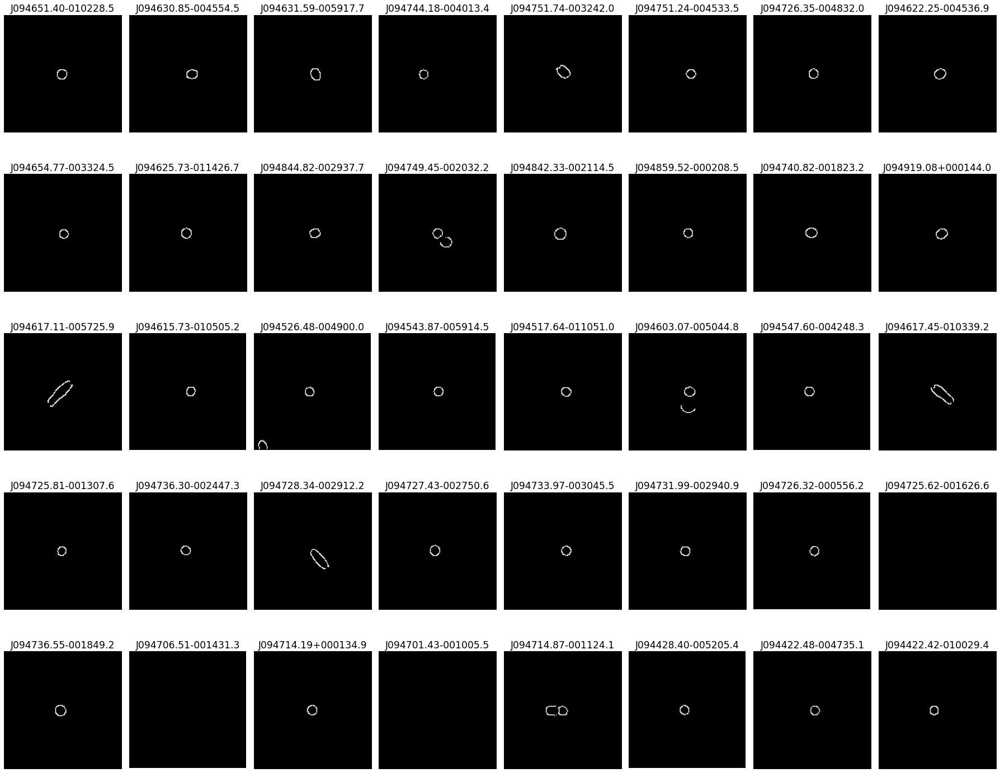

In [27]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

from skimage.morphology import area_closing, binary_closing


for galaxy, original_img_data in edited_galaxy_images.items():
    
    img_data = original_img_data
    blurred_img = skimage.filters.gaussian(img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=100, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    edges1 = feature.canny(blurred_img, sigma=3)
    ax[i].imshow(edges1, cmap='gray')
    ax[i].set_title(galaxy)
#     ax[i].imshow(img_data)

    for blob in blobs_dog:
            
        y, x, r = blob
        c = plt.Circle((x, y), r, color='green', linewidth=2, fill=False)

#         ax[i].add_patch(c)
        ax[i].set_axis_off()

    i += 1

plt.tight_layout()
plt.show()


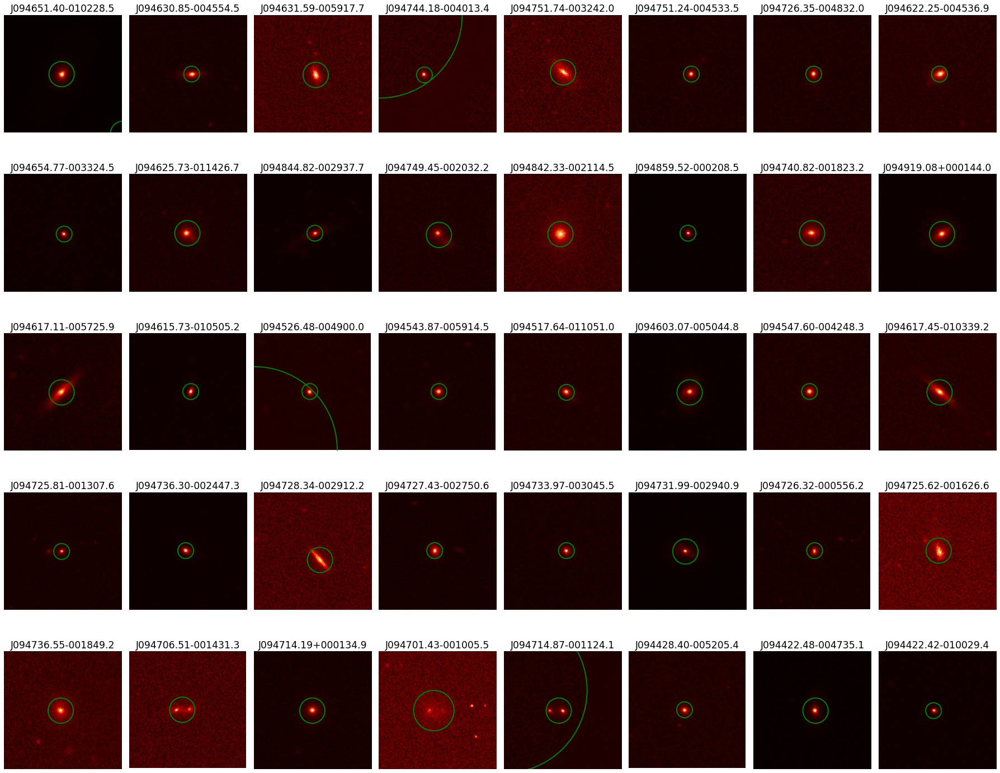

In [35]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

from skimage.morphology import area_closing, binary_closing


for galaxy, original_img_data in edited_galaxy_images.items():
    
    img_data = original_img_data
    blurred_img = skimage.filters.gaussian(img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=100, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    ax[i].set_title(galaxy)
    ax[i].imshow(img_data)
    
    for blob in blobs_dog:
            
        y, x, r = blob
        c = plt.Circle((x, y), r, color='green', linewidth=2, fill=False)

        ax[i].add_patch(c)
        ax[i].set_axis_off()


    i += 1

plt.tight_layout()
plt.show()


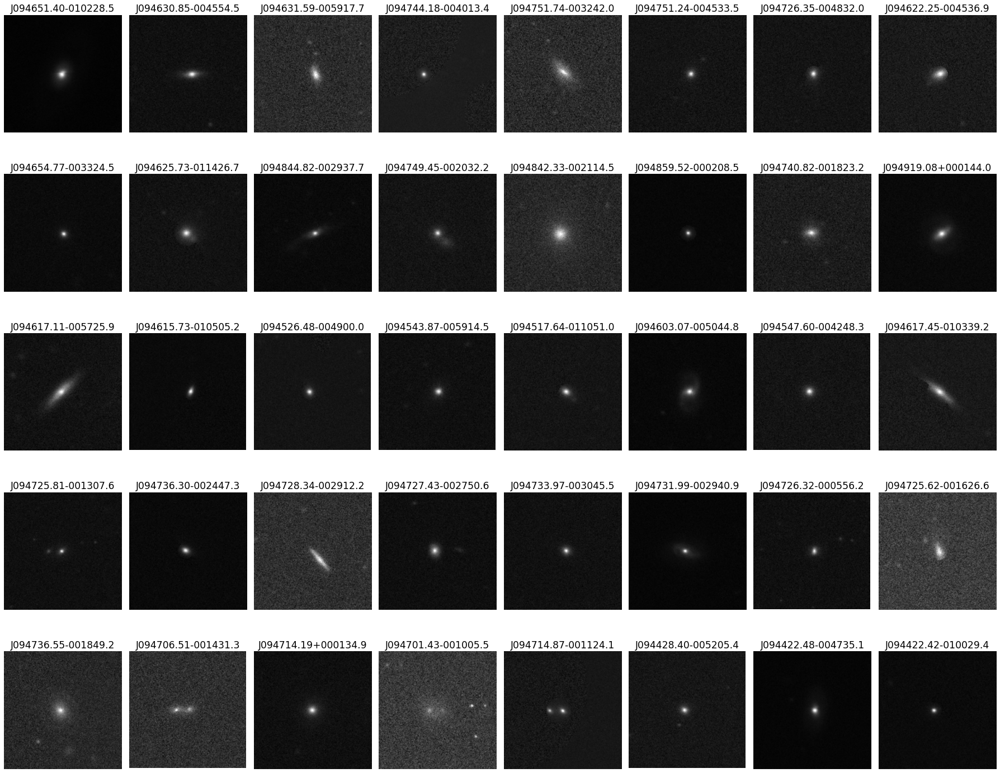

In [36]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0


for galaxy, original_img_data in edited_galaxy_images.items():

    blurred_img = skimage.filters.gaussian(original_img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=150, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    initialise = False
    center_point = [original_img_data.shape[0]/2, original_img_data.shape[1]/2]

    for blob in blobs_dog:
        
        y, x, r = blob
        center_of_blob = [x, y]


        if initialise == False:
            center_blob = blob
            dist_of_current_cb = find_len(center_of_blob, center_point)
            initialise = True
        
        else:
            
            check1 = find_len(center_of_blob, center_point) < dist_of_current_cb
            check2 = find_len(center_of_blob, center_point) < r
            
            if check1 == True and check2 == True:
                center_blob = blob
                dist_of_current_cb = find_len(center_of_blob, center_point)


    # mask

    outside_blobs = []

    for blob in blobs_dog:
        if np.any(blob != center_blob):
            outside_blobs.append(blob)

    def mask_outside_blobs(image, outside_blobs, center_blob):
        edited_image = image.copy()
        cb_y, cb_x, cb_r = center_blob
        for outside_blob in outside_blobs:
            
            y, x, r = outside_blob
            for i in range(image.shape[0]):
                for j in range(image.shape[1]):
                    if find_len([i, j], [x, y]) <= r and find_len([i, j], [cb_x, cb_y]) > cb_r:
                        edited_image[j][i] = np.NaN
        return edited_image

    

    def interpolate(image, center_blob):
        import random
        cb_y, cb_x, cb_r = center_blob
        copy = image.copy()
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if find_len([i, j], [cb_x, cb_y]) < cb_r:
                    copy[i][j] = np.NaN
        mean = np.nanmean(copy)
        std = np.nanstd(copy)
        
        new_image = image.copy()
        
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                if bool(np.isnan(new_image[i][j])):
                    new_image[i][j] = random.gauss(mean, std)

        return new_image
    
    cb_y, cb_x, cb_r = center_blob
    img_data = mask_outside_blobs(original_img_data, outside_blobs, center_blob) 
    img_data = interpolate(img_data, center_blob)

    ax[i].set_title(galaxy)
    ax[i].imshow(img_data, cmap='gray',) #norm = colors.LogNorm()
    ax[i].set_axis_off()
    
    i += 1
    
    edited_galaxy_images[galaxy] = img_data

plt.tight_layout()
plt.show()

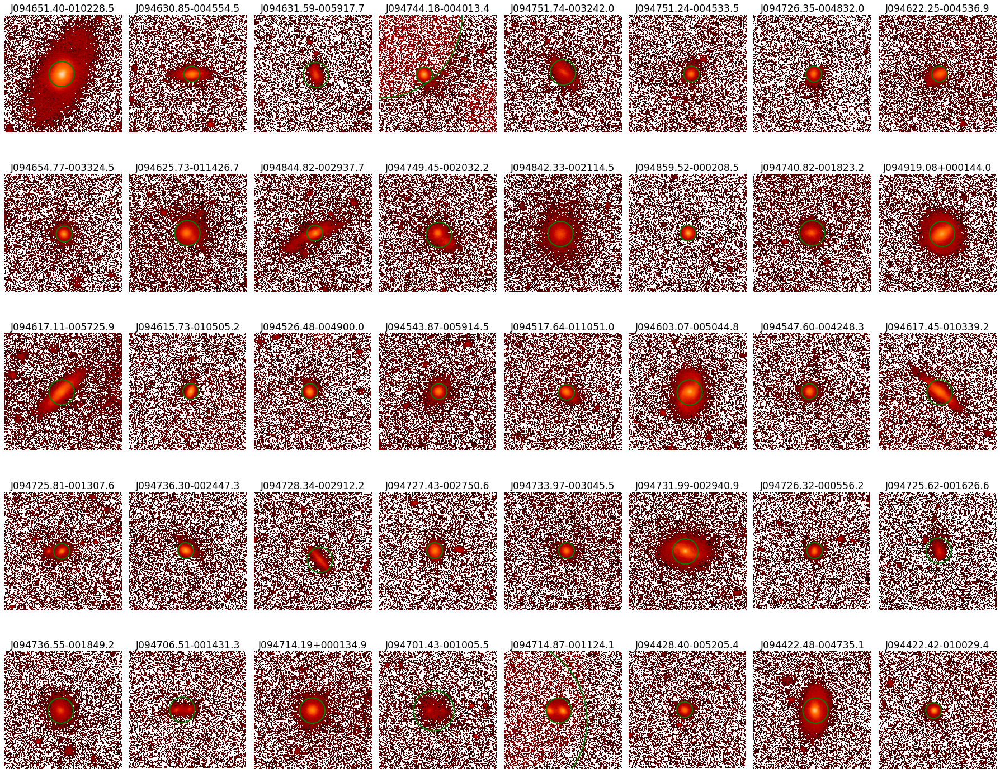

In [38]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

from skimage.morphology import area_closing, binary_closing


for galaxy, original_img_data in edited_galaxy_images.items():
    
    img_data = original_img_data
    blurred_img = skimage.filters.gaussian(img_data, sigma=3)
    blobs_dog = blob_dog(blurred_img, max_sigma=100, threshold=.1, exclude_border=False, overlap=1)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    ax[i].set_title(galaxy)
    ax[i].imshow(img_data, norm=norm)
    
    for blob in blobs_dog:
            
        y, x, r = blob
        c = plt.Circle((x, y), r, color='green', linewidth=2, fill=False)

        ax[i].add_patch(c)
        ax[i].set_axis_off()


    i += 1

plt.tight_layout()
plt.show()

In [30]:
from sklearn.decomposition import PCA, NMF
#from skimage.filters import threshold_otsu

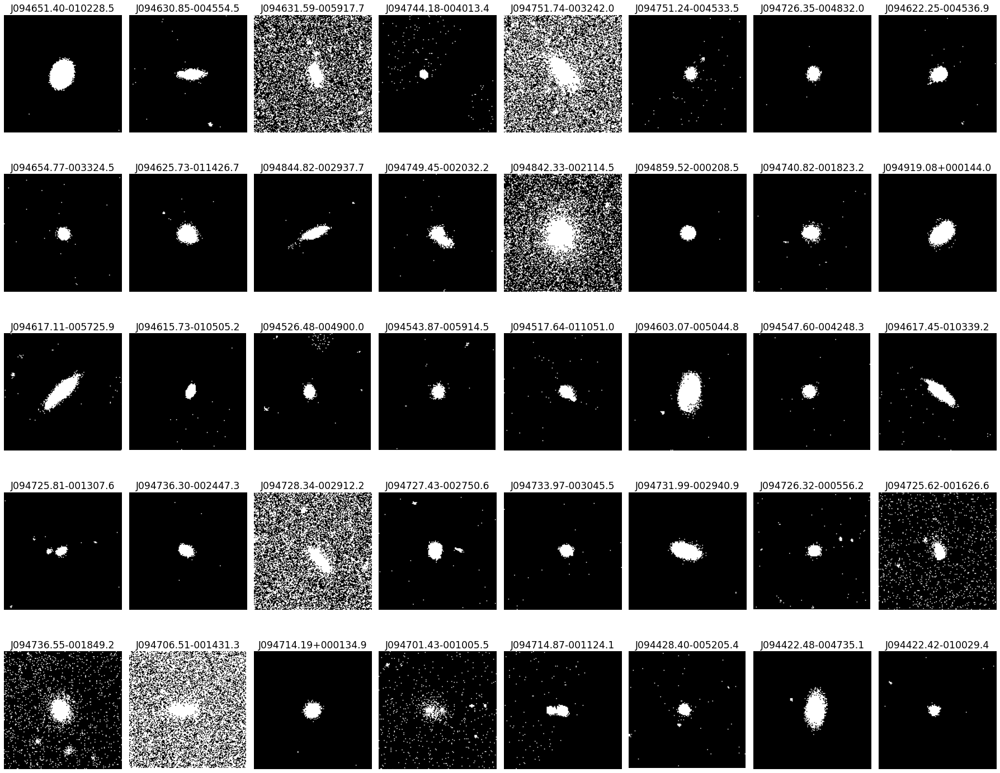

In [31]:
def get_orientation(pts, img):
    sz = len(pts)
    data_pts = np.empty((sz, 2), dtype=np.float64)
    for i in range(data_pts.shape[0]):
        data_pts[i,0] = pts[i,0,0]
        data_pts[i,1] = pts[i,0,1]
    # Perform PCA analysis
    mean = np.empty((0))
    mean, eigenvectors, eigenvalues = cv2.PCACompute2(data_pts, mean)
    # Store the center of the object
    cntr = (int(mean[0,0]), int(mean[0,1]))
    cv2.circle(img, cntr, 3, (255, 0, 255), 2)
    p1 = (cntr[0] + 0.02 * eigenvectors[0,0] * eigenvalues[0,0], cntr[1] + 0.02 *  eigenvectors[0,1] * eigenvalues[0,0])
    p2 = (cntr[0] - 0.02 * eigenvectors[1,0] * eigenvalues[1,0], cntr[1] - 0.02 * eigenvectors[1,1] * eigenvalues[1,0])
    draw_axis(img, cntr, p1, (0, 150, 0), 1)
    draw_axis(img, cntr, p2, (200, 150, 0), 5)
    angle = atan2(eigenvectors[0,1], eigenvectors[0,0]) # orientation in radians
    return angle

# for galaxy, edited_img_data in edited_galaxy_images.items():
#     fig, ax = try_all_threshold(edited_img_data, figsize=(10, 8), verbose=False)
#     plt.show()



fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0


for galaxy, edited_img_data in edited_galaxy_images.items():
    thresh = threshold_triangle(edited_img_data)
    binary = edited_img_data > thresh

    ax[i].set_title(galaxy)
    ax[i].imshow(binary, cmap='gray')
    ax[i].set_axis_off()

    i += 1

plt.tight_layout()
plt.show()



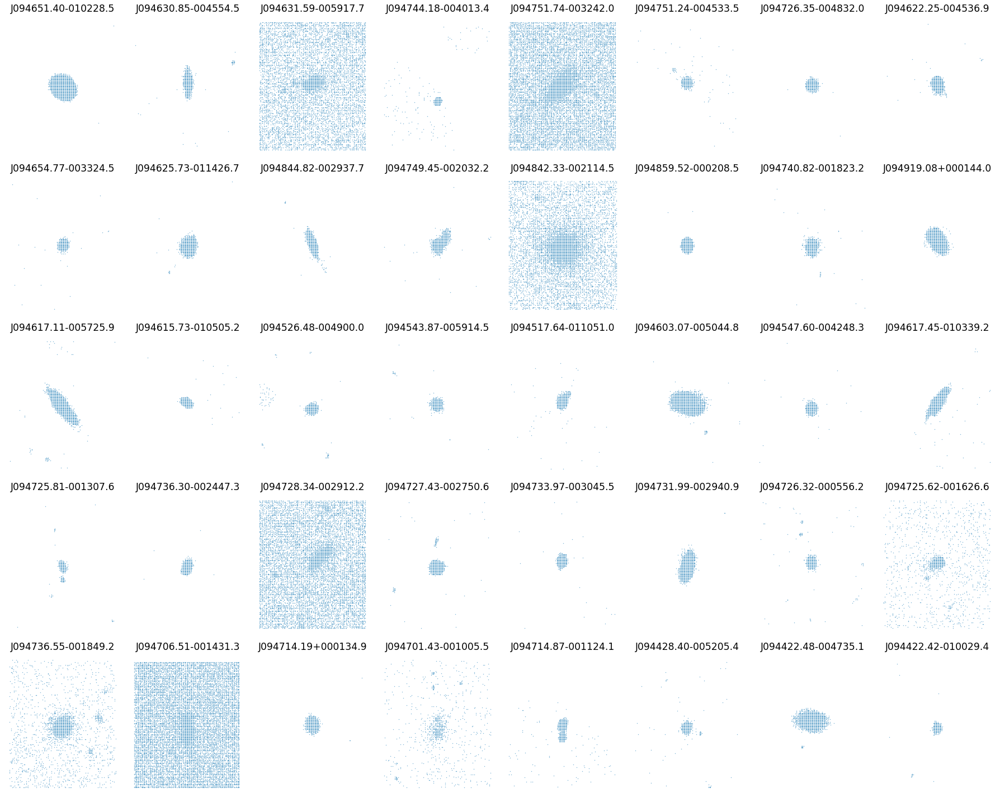

In [32]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

for galaxy, edited_img_data in edited_galaxy_images.items():
    thresh = threshold_triangle(edited_img_data)
    binary = edited_img_data > thresh
    
    x, y = np.where(binary>0)
    ax[i].set_title(galaxy)
    ax[i].scatter(x, y, s=0.1)
    ax[i].set_axis_off()

    i += 1

plt.tight_layout()
plt.show()

#     pca = PCA(n_components=2)
#     pca.fit(binary)

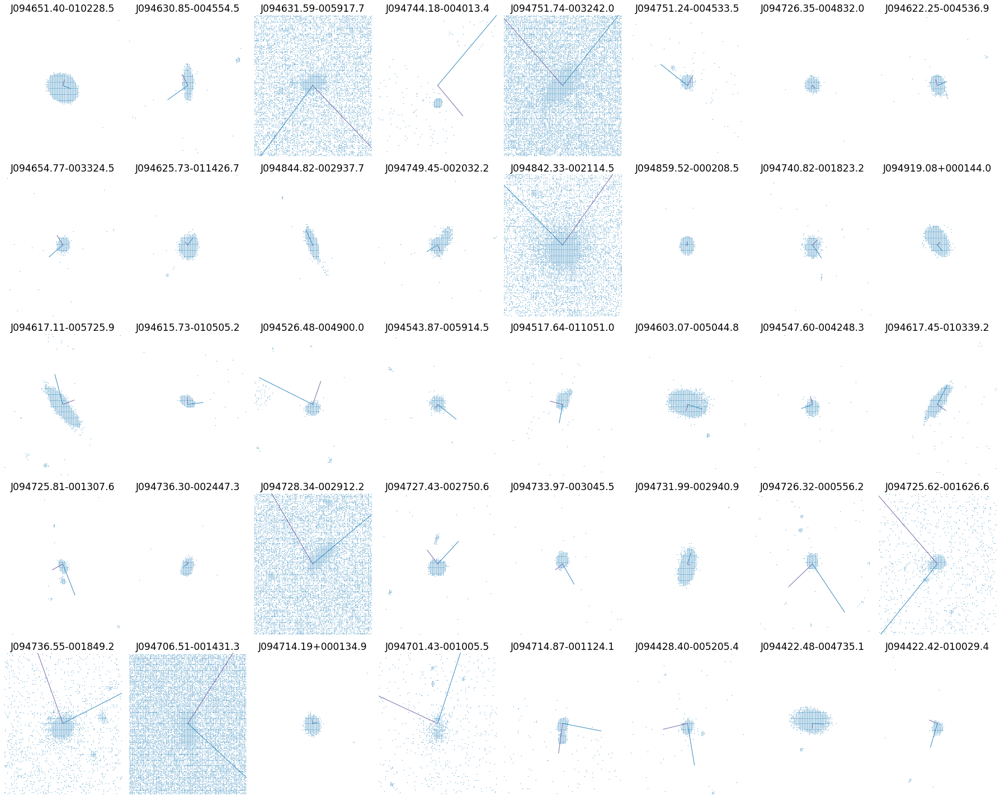

In [33]:
fig, axes = plt.subplots(5, 8, figsize=(25, 20), sharex=True, sharey=True)
ax = axes.ravel()
i = 0

for galaxy, edited_img_data in edited_galaxy_images.items():
    thresh = threshold_triangle(edited_img_data)
    binary = edited_img_data > thresh
    x, y = np.where(binary>0)
    
#     x = []
#     y = []
    
#     for i in binary.shape[0]:
#         for j in binary.shape[1]:
#             if binary[i][j] == True:
    
    
    xy = list(zip(x, y))
    xy = np.array(xy)
    pca = PCA(n_components=2)
    pca.fit(xy-(binary.shape[0]/2))

    
    ax[i].set_title(galaxy)
    ax[i].scatter(x-(binary.shape[0]/2), y-(binary.shape[0]/2), s=0.1)
    for (comp, var) in zip(pca.components_, pca.explained_variance_):
        comp = comp * (var/10)  # scale component by its variance explanation power
        ax[i].plot(
            [0, comp[0]],
            [0, comp[1]],
            linewidth=1,
        )
    ax[i].set_axis_off()
    ax[i].set_xlim(-binary.shape[0]/2, binary.shape[0]/2)
    ax[i].set_ylim(-binary.shape[0]/2, binary.shape[0]/2)
    i += 1
    
plt.tight_layout()
plt.show()